In [1]:
!pip3 install -q xlrd xlwt
!pip3 install -q openpyxl
!pip3 install -q scipy
!pip3 install -q pandas
!pip3 install -q matplotlib
!pip3 install -q seaborn
# !pip3 install -q keras
!pip3 install -q tensorflow



In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import itertools


# Make numpy printouts easier to read.
np.set_printoptions(precision=3, suppress=True)


markers_cycler = itertools.cycle(('o', 'v', '^', '<', '>', 's', 'D','8', 'p','*','h','H','d','+','X',))  
linestyle_cycler = itertools.cycle(('-', '--', '-.', ':', '', (0, (1, 10)), (0, (1, 1)), (0, (1, 1)), (0, (5, 10)), (0, (5, 5)), (0, (5, 1)), (0, (3, 10, 1, 10)), (0, (3, 5, 1, 5)),(0, (3, 1, 1, 1)),(0, (3, 5, 1, 5, 1, 5)),(0, (3, 10, 1, 10, 1, 10)), (0, (3, 1, 1, 1, 1, 1))))

In [3]:
fileData = 'vehicleEms'

dataFolder = 'data'
# rawPath = os.path.join(dataFolder, fileData + '.xlsx')
# rawDataset = pd.read_excel(rawPath, engine='openpyxl')

rawPath = os.path.join(dataFolder, fileData + '.xls')
rawDataset = pd.read_excel(rawPath, 
                            index_col=0
                            )

# create result folder
outFolder = 'dataOut'
if not os.path.exists(outFolder):
    os.mkdir(outFolder)

# create work result folder
workPath = os.path.join(outFolder, fileData)
if not os.path.exists(workPath):
    os.mkdir(workPath)

filePath = os.path.join(workPath, fileData)

In [4]:
# rawDataset = pd.read_excel('.xls', index_col=0)
rawDataset

,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.00,13.5,1.55,0,1.08,Passed,Passed,8,Car,Passed,Passed,15.876,Passed,Passed
2,2,Honda,2007,Petrol,Commercial,0.00,14.7,0.08,10,1.00,Passed,Passed,7,Jeep,Passed,Passed,14.744,Passed,Passed
3,3,Toyota,2011,Petrol,Commercial,0.00,14.6,0.72,1,1.04,Passed,Passed,3,Car,Passed,Passed,15.244,Passed,Passed
4,4,Toyota,1998,Petrol,Official,0.00,10.2,3.15,1,1.22,Passed,Passed,16,Car,Passed,Passed,17.934,Passed,Passed
5,5,Toyota,2002,Petrol,Official,0.00,14.5,0.60,1,1.03,Passed,Passed,12,Car,Passed,Passed,15.141,Passed,Passed
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,Toyota,1987,Petrol,Private,4.49,5.8,11.29,603,1.51,Failed,Failed,27,Car,Failed,Failed,22.256,Passed,Failed
2762,2797,Toyota,2007,Petrol,Commercial,4.51,11.9,0.47,388,0.88,Failed,Failed,7,Car,Failed,Failed,12.995,Failed,Failed
2763,2798,Nissan,1984,Petrol,Private,4.51,10.9,1.55,203,0.93,Failed,Failed,30,Car,Failed,Failed,13.700,Failed,Failed


In [5]:
rawDataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2765 entries, 1 to 2765
Data columns (total 19 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   SN           2765 non-null   int64  
 1   Make         2765 non-null   object 
 2   Yr           2765 non-null   int64  
 3   FuelType     2765 non-null   object 
 4   VehicleUse   2765 non-null   object 
 5   CO           2765 non-null   float64
 6   CO2          2765 non-null   float64
 7   O2           2765 non-null   float64
 8   HC           2765 non-null   int64  
 9   lamda        2764 non-null   float64
 10  Study        2765 non-null   object 
 11  OGEPA        2765 non-null   object 
 12  Age          2765 non-null   int64  
 13  VehicleType  2765 non-null   object 
 14  EUROII       2765 non-null   object 
 15  NESREAI      2765 non-null   object 
 16  AFR          2765 non-null   float64
 17  NESREAII     2765 non-null   object 
 18  EUROIII      2765 non-null   object 
dtypes: flo

In [6]:
dataset = rawDataset.copy()
dataset.head()

,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.0,13.5,1.55,0,1.08,Passed,Passed,8,Car,Passed,Passed,15.876,Passed,Passed
2,2,Honda,2007,Petrol,Commercial,0.0,14.7,0.08,10,1.00,Passed,Passed,7,Jeep,Passed,Passed,14.744,Passed,Passed
3,3,Toyota,2011,Petrol,Commercial,0.0,14.6,0.72,1,1.04,Passed,Passed,3,Car,Passed,Passed,15.244,Passed,Passed
4,4,Toyota,1998,Petrol,Official,0.0,10.2,3.15,1,1.22,Passed,Passed,16,Car,Passed,Passed,17.934,Passed,Passed
5,5,Toyota,2002,Petrol,Official,0.0,14.5,0.60,1,1.03,Passed,Passed,12,Car,Passed,Passed,15.141,Passed,Passed


In [7]:
dataset.isna().sum()

SN             0
Make           0
Yr             0
FuelType       0
VehicleUse     0
CO             0
CO2            0
O2             0
HC             0
lamda          1
Study          0
OGEPA          0
Age            0
VehicleType    0
EUROII         0
NESREAI        0
AFR            0
NESREAII       0
EUROIII        0
dtype: int64

In [8]:
dataset = dataset.dropna()

In [9]:
boolCols = ['Study', 'OGEPA', 'EUROII', 'NESREAI', 'NESREAII', 'EUROIII']

for col in boolCols:
    dict_colData = { x:i+2 for i,x in enumerate(rawDataset[col].unique())}
    dict_colData['Failed']=0
    dict_colData['Passed']=1
    print(dict_colData)
    dataset[col] = dataset[col].map(dict_colData)
    
# dataset = pd.get_dummies(dataset, prefix=prefix, prefix_sep='_')
dataset

{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}
{'Passed': 1, 'Failed': 0}


,SN,Make,Yr,FuelType,VehicleUse,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,VehicleType,EUROII,NESREAI,AFR,NESREAII,EUROIII
N,,,,,,,,,,,,,,,,,,,
1,1,Honda,2006,Petrol,Commercial,0.00,13.5,1.55,0,1.08,1,1,8,Car,1,1,15.876,1,1
2,2,Honda,2007,Petrol,Commercial,0.00,14.7,0.08,10,1.00,1,1,7,Jeep,1,1,14.744,1,1
3,3,Toyota,2011,Petrol,Commercial,0.00,14.6,0.72,1,1.04,1,1,3,Car,1,1,15.244,1,1
4,4,Toyota,1998,Petrol,Official,0.00,10.2,3.15,1,1.22,1,1,16,Car,1,1,17.934,1,1
5,5,Toyota,2002,Petrol,Official,0.00,14.5,0.60,1,1.03,1,1,12,Car,1,1,15.141,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,Toyota,1987,Petrol,Private,4.49,5.8,11.29,603,1.51,0,0,27,Car,0,0,22.256,1,0
2762,2797,Toyota,2007,Petrol,Commercial,4.51,11.9,0.47,388,0.88,0,0,7,Car,0,0,12.995,0,0
2763,2798,Nissan,1984,Petrol,Private,4.51,10.9,1.55,203,0.93,0,0,30,Car,0,0,13.700,0,0


In [10]:
prefix = ['Make', 'FuelType', 'VehicleUse', 'VehicleType']
dataset = pd.get_dummies(dataset, prefix=prefix, prefix_sep='_')
dataset

,SN,Yr,CO,CO2,O2,HC,lamda,Study,OGEPA,Age,...,VehicleUse_Commercial,VehicleUse_Official,VehicleUse_Private,VehicleType_Bullion V,VehicleType_Bus,VehicleType_CABSTAR,VehicleType_Car,VehicleType_Jeep,VehicleType_PICK-UP,VehicleType_TRUCK
N,,,,,,,,,,,,,,,,,,,,,
1,1,2006,0.00,13.5,1.55,0,1.08,1,1,8,...,1,0,0,0,0,0,1,0,0,0
2,2,2007,0.00,14.7,0.08,10,1.00,1,1,7,...,1,0,0,0,0,0,0,1,0,0
3,3,2011,0.00,14.6,0.72,1,1.04,1,1,3,...,1,0,0,0,0,0,1,0,0,0
4,4,1998,0.00,10.2,3.15,1,1.22,1,1,16,...,0,1,0,0,0,0,1,0,0,0
5,5,2002,0.00,14.5,0.60,1,1.03,1,1,12,...,0,1,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2761,2796,1987,4.49,5.8,11.29,603,1.51,0,0,27,...,0,0,1,0,0,0,1,0,0,0
2762,2797,2007,4.51,11.9,0.47,388,0.88,0,0,7,...,1,0,0,0,0,0,1,0,0,0
2763,2798,1984,4.51,10.9,1.55,203,0.93,0,0,30,...,0,0,1,0,0,0,1,0,0,0


In [11]:
dataset.columns

Index(['SN', 'Yr', 'CO', 'CO2', 'O2', 'HC', 'lamda', 'Study', 'OGEPA', 'Age',
       'EUROII', 'NESREAI', 'AFR', 'NESREAII', 'EUROIII', 'Make_Honda',
       'Make_Mazda', 'Make_Mercedez B', 'Make_Mitsubushi', 'Make_Nissan',
       'Make_Peugeot', 'Make_Toyota', 'Make_Volkswagen', 'FuelType_Petrol',
       'VehicleUse_Commercial', 'VehicleUse_Official', 'VehicleUse_Private',
       'VehicleType_Bullion V', 'VehicleType_Bus', 'VehicleType_CABSTAR',
       'VehicleType_Car', 'VehicleType_Jeep', 'VehicleType_PICK-UP',
       'VehicleType_TRUCK'],
      dtype='object')

In [12]:
outFeatures = ['CO', 'CO2', 'O2', 'HC', 'lamda', 'Study', 'OGEPA', 
       'EUROII', 'NESREAI', 'AFR', 'NESREAII', 'EUROIII']
inFeatures = ['Age', 'Make_Honda',
       'Make_Mazda', 'Make_Mercedez B', 'Make_Mitsubushi', 'Make_Nissan',
       'Make_Peugeot', 'Make_Toyota', 'Make_Volkswagen', 'FuelType_Petrol',
       'VehicleUse_Commercial', 'VehicleUse_Official', 'VehicleUse_Private',
       'VehicleType_Bullion V', 'VehicleType_Bus', 'VehicleType_CABSTAR',
       'VehicleType_Car', 'VehicleType_Jeep', 'VehicleType_PICK-UP',
       'VehicleType_TRUCK']

In [13]:
favCols0 = ['CO', 'CO2', 'O2', 'HC', 'Age', 'lamda', 'AFR', 'Study']
favCols = ['CO', 'CO2', 'O2', 'HC', 'Age', 'Study']

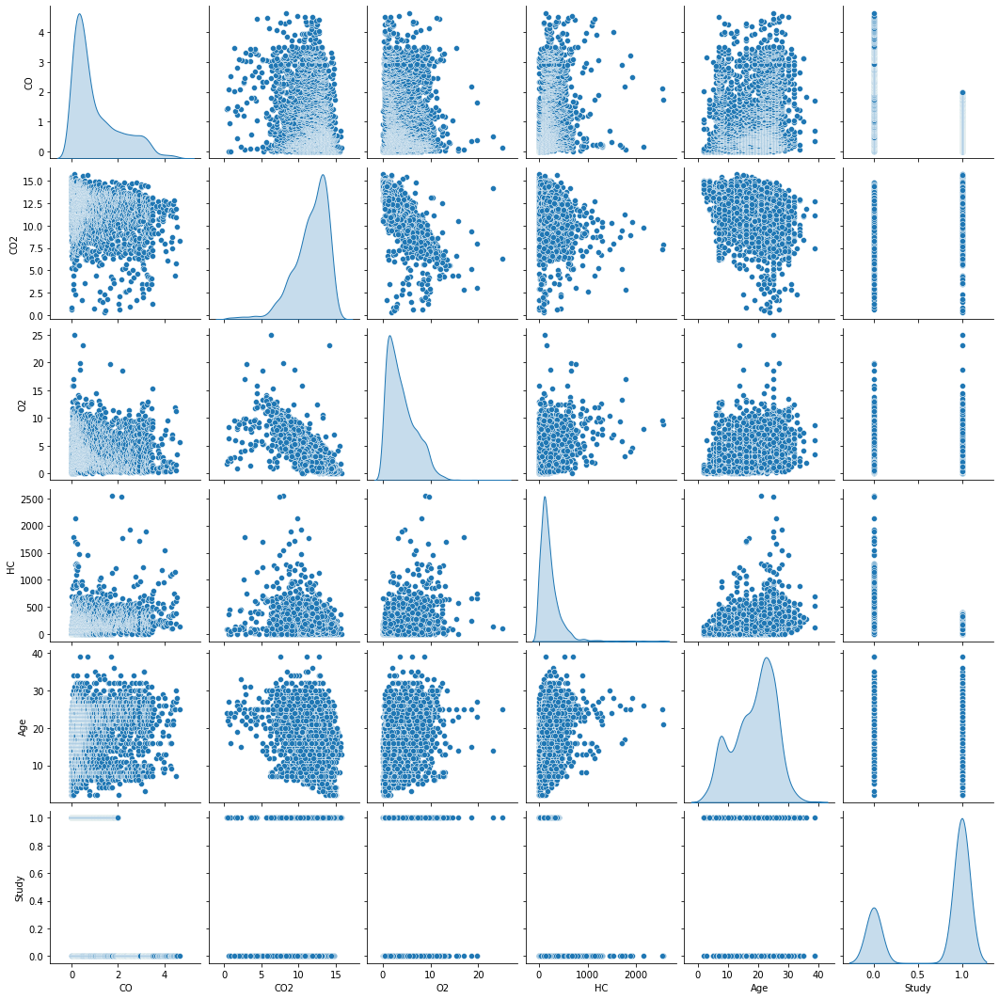

In [14]:
sns.pairplot(dataset[favCols], diag_kind='kde')

fname = filePath + '_pairplot_fav'

plt.savefig(fname + '.svg')
plt.savefig(fname + '.png')

plt.show()


In [15]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2764 entries, 1 to 2765
Data columns (total 34 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   SN                     2764 non-null   int64  
 1   Yr                     2764 non-null   int64  
 2   CO                     2764 non-null   float64
 3   CO2                    2764 non-null   float64
 4   O2                     2764 non-null   float64
 5   HC                     2764 non-null   int64  
 6   lamda                  2764 non-null   float64
 7   Study                  2764 non-null   int64  
 8   OGEPA                  2764 non-null   int64  
 9   Age                    2764 non-null   int64  
 10  EUROII                 2764 non-null   int64  
 11  NESREAI                2764 non-null   int64  
 12  AFR                    2764 non-null   float64
 13  NESREAII               2764 non-null   int64  
 14  EUROIII                2764 non-null   int64  
 15  Make

In [16]:
dataset.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
SN,2764.0,1415.722865,802.523630,1.000,727.7500,1418.500,2109.2500,2800.00
Yr,2764.0,1995.152315,6.863460,1975.000,1990.0000,1994.000,2000.0000,2012.00
CO,2764.0,1.037435,1.016247,0.000,0.2800,0.610,1.5800,4.65
CO2,2764.0,11.625315,2.363758,0.300,10.4000,12.100,13.4000,15.80
O2,2764.0,3.964012,3.017331,0.020,1.5475,3.210,5.7450,25.00
HC,2764.0,210.441027,217.624778,0.000,94.0000,158.000,273.2500,2547.00
lamda,2764.0,1.680340,20.366994,0.010,1.0400,1.140,1.3200,1055.00
Study,2764.0,0.722504,0.447845,0.000,0.0000,1.000,1.0000,1.00
OGEPA,2764.0,0.894356,0.307437,0.000,1.0000,1.000,1.0000,1.00
Age,2764.0,18.847685,6.863460,2.000,14.0000,20.000,24.0000,39.00


In [17]:
interestCols = outFeatures + inFeatures
interestCols

['CO',
 'CO2',
 'O2',
 'HC',
 'lamda',
 'Study',
 'OGEPA',
 'EUROII',
 'NESREAI',
 'AFR',
 'NESREAII',
 'EUROIII',
 'Age',
 'Make_Honda',
 'Make_Mazda',
 'Make_Mercedez B',
 'Make_Mitsubushi',
 'Make_Nissan',
 'Make_Peugeot',
 'Make_Toyota',
 'Make_Volkswagen',
 'FuelType_Petrol',
 'VehicleUse_Commercial',
 'VehicleUse_Official',
 'VehicleUse_Private',
 'VehicleType_Bullion V',
 'VehicleType_Bus',
 'VehicleType_CABSTAR',
 'VehicleType_Car',
 'VehicleType_Jeep',
 'VehicleType_PICK-UP',
 'VehicleType_TRUCK']

In [18]:
dataX = dataset[interestCols].copy()


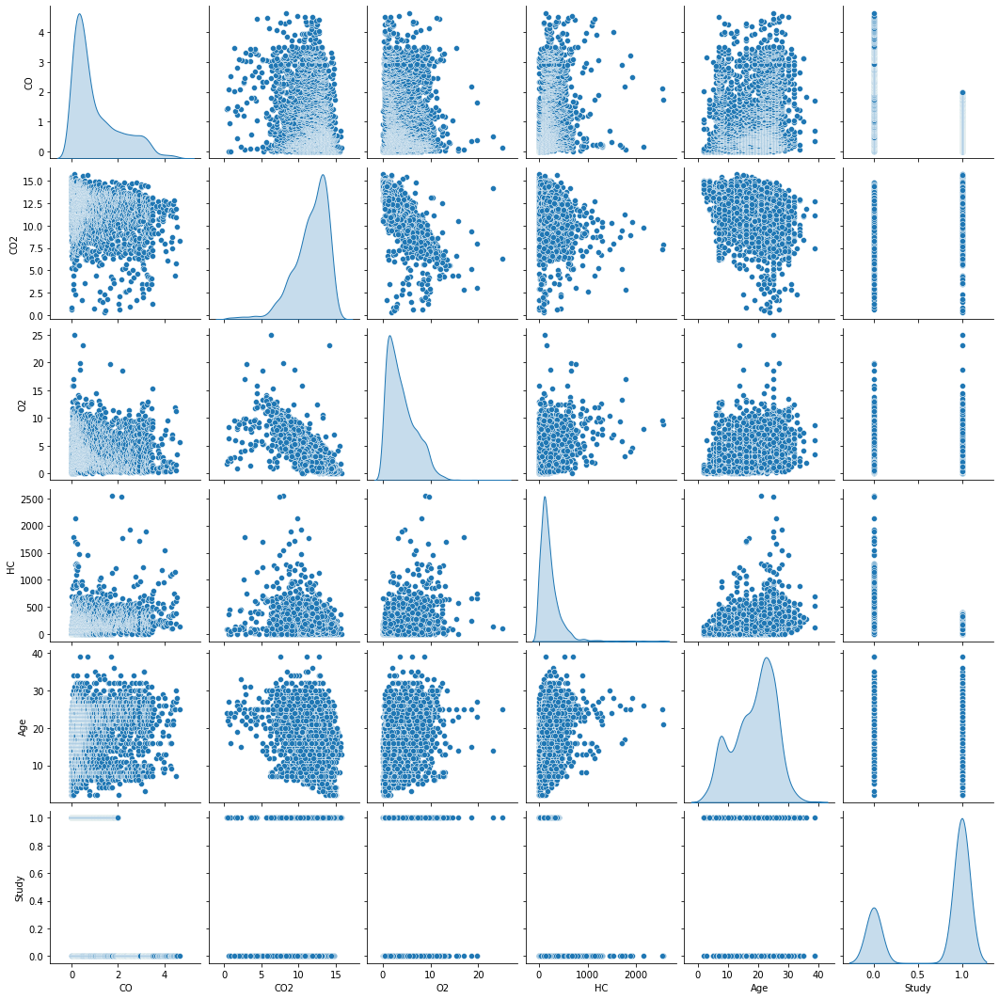

In [19]:
h = 1

X = dataX.loc[::h]
sns.pairplot(X[favCols], diag_kind='kde')

fname = filePath + '_pairplot_X'

plt.savefig(fname + '.svg')
plt.savefig(fname + '.png')

plt.show()


In [20]:
def plot_hist(x, xlabel, ylabel, label=None, colorNo=1, fname='plot_hist'):
    fig, ax = plt.subplots()

    for i in range(colorNo):
        color = next(ax._get_lines.prop_cycler)['color']

    # ax.hist(x, bins=25)
    ax.hist(x, 10,  
            facecolor=color,
            alpha=0.5, label=col)

    ax.set_xlabel(xlabel)
    _ = ax.set_ylabel(ylabel)

    # Shrink current axis by 20%
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Put a legend to the right of the current axis
    ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')

    plt.show()

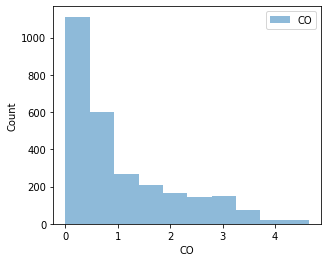

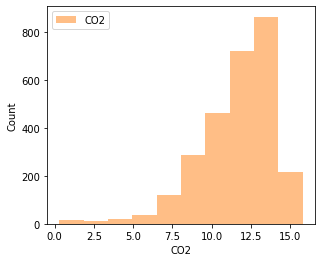

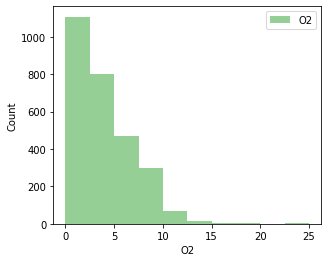

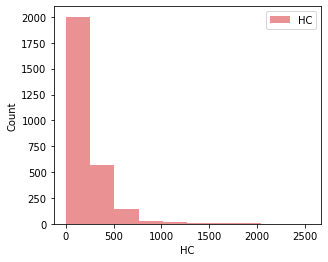

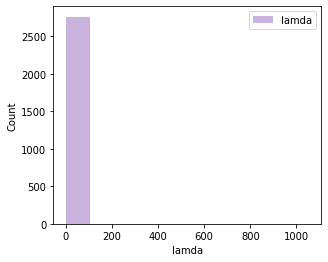

...

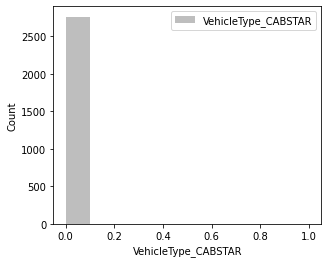

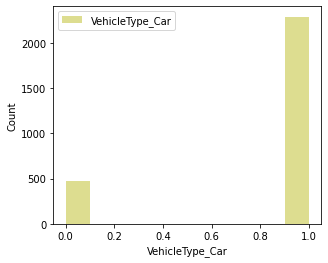

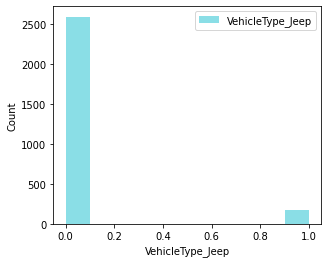

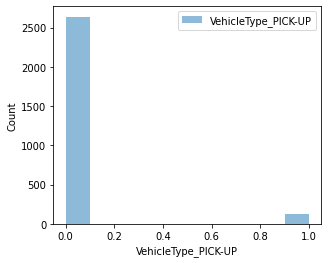

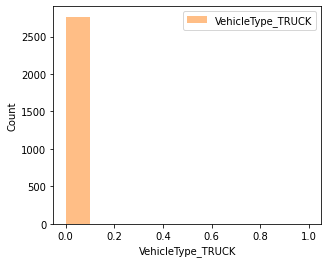

In [21]:

X = dataX.loc[::h]
colNames = X.columns

for i,col in enumerate(colNames):
    x = X[col]
    label=col

    xlabel = col
    ylabel = 'Count'

    fname = filePath + '_hist_' + col

    plot_hist(x, xlabel, ylabel, label, colorNo=i+1, fname=fname)

# fig.subplots_adjust(left=0, right=1, bottom=0, top=0.5, hspace=0.05, wspace=1)


In [22]:
X = dataX.loc[::h]
corr = X.corr()
corr

,CO,CO2,O2,HC,lamda,Study,OGEPA,EUROII,NESREAI,AFR,...,VehicleUse_Commercial,VehicleUse_Official,VehicleUse_Private,VehicleType_Bullion V,VehicleType_Bus,VehicleType_CABSTAR,VehicleType_Car,VehicleType_Jeep,VehicleType_PICK-UP,VehicleType_TRUCK
CO,1.000000,-0.242854,-0.039226,0.253704,-0.008186,-0.693239,-0.511612,-0.549695,-0.237881,-0.008188,...,0.050400,0.040416,-0.069709,-0.019000,0.055005,-0.004169,-0.013221,-0.090951,0.063373,0.038057
CO2,-0.242854,1.000000,-0.776562,-0.249356,0.011059,0.305219,0.259607,0.274988,0.208638,0.011062,...,0.093523,0.115082,-0.160301,0.001420,0.038767,-0.044125,-0.095827,0.125983,-0.010950,0.000601
O2,-0.039226,-0.776562,1.000000,0.250993,-0.007000,-0.135255,-0.152637,-0.152477,-0.185652,-0.007002,...,-0.132240,-0.127235,0.199263,0.006788,-0.045263,0.050808,0.098119,-0.110162,-0.003982,-0.018881
HC,0.253704,-0.249356,0.250993,1.000000,-0.008066,-0.544940,-0.503320,-0.628124,-0.635892,-0.008064,...,0.004815,0.021329,-0.020145,-0.017925,-0.019706,0.016456,0.069173,-0.085064,-0.002922,-0.015864
lamda,-0.008186,0.011059,-0.007000,-0.008066,1.000000,0.013250,0.006789,0.013563,0.004137,1.000000,...,-0.010209,-0.000606,0.008268,-0.000522,0.007313,0.000052,0.002341,-0.006654,-0.005023,-0.000682
Study,-0.693239,0.305219,-0.135255,-0.544940,0.013250,1.000000,0.554573,0.761167,0.403938,0.013252,...,-0.040341,-0.015012,0.042411,0.016677,-0.014725,-0.013372,-0.009718,0.086639,-0.062117,-0.030697
OGEPA,-0.511612,0.259607,-0.152637,-0.503320,0.006789,0.554573,1.000000,0.530105,0.728377,0.006791,...,-0.023970,-0.051545,0.058108,0.009248,-0.007309,0.009248,-0.000235,0.048022,-0.043387,-0.055353
EUROII,-0.549695,0.274988,-0.152477,-0.628124,0.013563,0.761167,0.530105,1.000000,0.386117,0.013566,...,-0.014496,0.012804,0.001190,0.017447,0.002574,-0.012029,-0.046847,0.098587,-0.029299,-0.029343
NESREAI,-0.237881,0.208638,-0.185652,-0.635892,0.004137,0.403938,0.728377,0.386117,1.000000,0.004136,...,-0.039702,-0.063958,0.079710,0.006736,0.002019,0.006736,0.004266,0.025116,-0.041008,0.004762
AFR,-0.008188,0.011062,-0.007002,-0.008064,1.000000,0.013252,0.006791,0.013566,0.004136,1.000000,...,-0.010208,-0.000603,0.008265,-0.000524,0.007312,0.000054,0.002342,-0.006658,-0.005021,-0.000681


In [23]:
nonCorrCols = list(corr[corr.isna().sum() > 1].index)
nonCorrCols

['FuelType_Petrol']

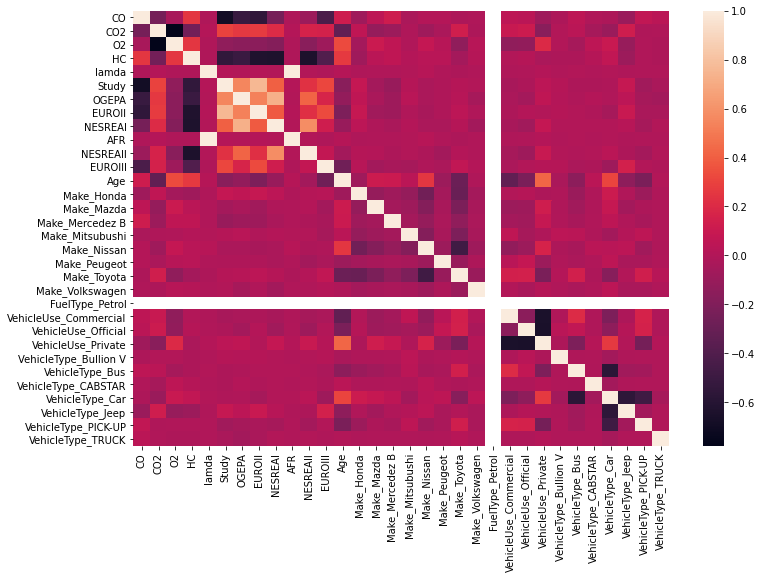

In [24]:
fig, ax = plt.subplots(figsize=(12,8))

sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values, 
            ax=ax)

fname = filePath + '_corr_all'

plt.savefig(fname + '.svg')
plt.savefig(fname + '.png')

plt.show()

In [25]:
correlatedCols = []

for c in dataX:
       for n in nonCorrCols:
              if c == n:
                     break
       else:
              correlatedCols.append(c)

              


correlatedCols 

['CO',
 'CO2',
 'O2',
 'HC',
 'lamda',
 'Study',
 'OGEPA',
 'EUROII',
 'NESREAI',
 'AFR',
 'NESREAII',
 'EUROIII',
 'Age',
 'Make_Honda',
 'Make_Mazda',
 'Make_Mercedez B',
 'Make_Mitsubushi',
 'Make_Nissan',
 'Make_Peugeot',
 'Make_Toyota',
 'Make_Volkswagen',
 'VehicleUse_Commercial',
 'VehicleUse_Official',
 'VehicleUse_Private',
 'VehicleType_Bullion V',
 'VehicleType_Bus',
 'VehicleType_CABSTAR',
 'VehicleType_Car',
 'VehicleType_Jeep',
 'VehicleType_PICK-UP',
 'VehicleType_TRUCK']

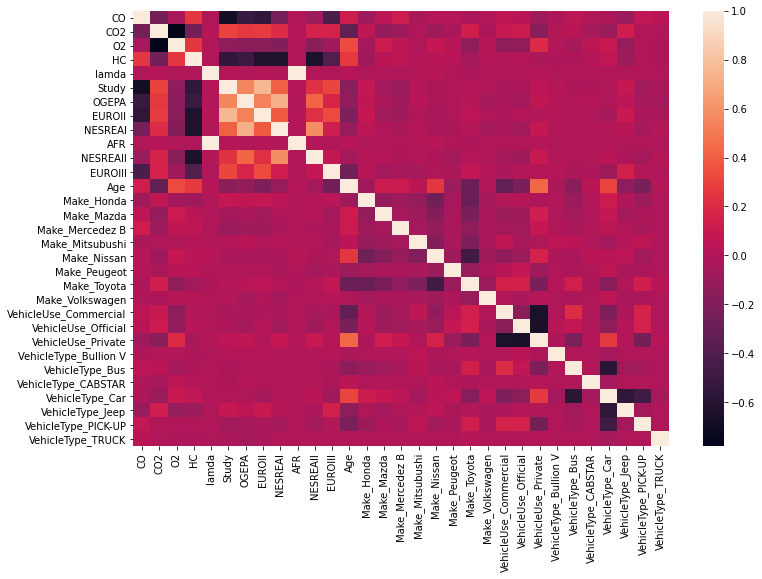

In [26]:

X = X[correlatedCols]
corr = X.corr()

fig, ax = plt.subplots(figsize=(12,8))

sns.heatmap(corr, 
            xticklabels=corr.columns.values,
            yticklabels=corr.columns.values, 
            ax=ax)

fname = filePath + '_corr'

plt.savefig(fname + '.svg')
plt.savefig(fname + '.png')

plt.show()

In [27]:
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.layers.experimental import preprocessing

print(tf.__version__)

2.4.1


In [28]:
def build_and_compile_model(norm, optimizer, loss, input_dim, metrics=None):
    model = keras.Sequential([
      norm,
      layers.Dense(64, activation='relu'),
      layers.Dense(64, activation='relu'),
      layers.Dense(1)
      ])

    # model.compile(loss='mean_absolute_error', optimizer=tf.keras.optimizers.Adam(0.001))
    model.compile(loss=loss, optimizer=optimizer, metrics=metrics)

    return model

In [29]:
def fit_evaluate(X_train, y_train, X_test, y_test, epochs=100):
    # fit
    history = model.fit(X_train, y_train, 
        epochs=epochs, 
        verbose=0,
        # Calculate validation results on 20% of the training data
        validation_split = 0.2)


    loss_value, metrics_value = model.evaluate(X_test, y_test, verbose=0)

    y_pred = model.predict(X_test)
    r2 = r2_score(y_test, y_pred)

    return history, loss_value, metrics_value, r2

In [30]:
def plot_loss(history, ylabel='Error [Y]', colorNo=1, text=None, fname='plot_loss'):
    fig, ax = plt.subplots(tight_layout=True)

    for i in range(colorNo):
        color = next(ax._get_lines.prop_cycler)['color']
    color2 = next(ax._get_lines.prop_cycler)['color']   

    ax.plot(history.history['loss'], label='loss', color=color)

    ax.plot(history.history['val_loss'], label='val_loss', color=color2)

    #   ax.ylim([0, 10])
    ax.set_xlabel('Epoch')
    ax.set_ylabel(ylabel)
    
    # title
    ax.set_title(text)

    # Shrink current axis by 20%
    box = ax.get_position()
    ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Put a legend to the right of the current axis
    ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

    ax.grid(True)

    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')

    plt.show()

In [31]:
def plot_model(x, y, sx, sy, xlabel, ylabel, colorNo=1, text=None, fname='plot_model'):
    fig, ax = plt.subplots(tight_layout=True)

    for i in range(colorNo):
        color = next(ax._get_lines.prop_cycler)['color']
    color2 = next(ax._get_lines.prop_cycler)['color']

    ax.scatter(sx, sy, label='Data', color=color)
    ax.plot(x, y, 
        # color='k', 
        color=color2,
        label='Predictions')

    ax.xlabel(xlabel)
    ax.ylabel(ylabel)
    
    # title
    ax.set_title(text)

    # # Shrink current axis by 20%
    # box = ax.get_position()
    # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # Put a legend to the right of the current axis
    ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')

    plt.show()


In [32]:
def plot_prediction(y, yPred, xlabel='True Values [Y]', ylabel='Predictions [Y]', lims=[0, 20], colorNo=1, text=None, fname='plot_prediction'):
    fig, ax = plt.subplots(
        # tight_layout=True
        )

    for i in range(colorNo):
        color = next(ax._get_lines.prop_cycler)['color']
    color2 = next(ax._get_lines.prop_cycler)['color']

    ax = plt.axes(aspect='equal')
    ax.scatter(y, yPred, color=color)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    # lims = [0, 20]
    ax.set_xlim(lims)
    ax.set_ylim(lims)
    _ = ax.plot(lims, lims, color=color2)

    # title
    ax.set_title(text)

    # # Shrink current axis by 20%
    # box = ax.get_position()
    # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # # Put a legend to the right of the current axis
    # ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))


    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')

    plt.show()


In [33]:
def plot_error_hist(error, xlabel, ylabel, colorNo=1, text=None, fname='plot_error_hist'):
    fig, ax = plt.subplots(tight_layout=True)

    for i in range(colorNo):
        color = next(ax._get_lines.prop_cycler)['color']

    ax.hist(error, bins=25, facecolor=color)
    ax.set_xlabel(xlabel)
    _ = ax.set_ylabel(ylabel)

    # title
    ax.set_title(text)

    # # Shrink current axis by 20%
    # box = ax.get_position()
    # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

    # # Put a legend to the right of the current axis
    # ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))


    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')

    plt.show()

In [34]:
def get_lim0(x,y):
    x1,x2,y1,y2 = (min(x), max(x), min(y), max(y))
    llim = x1
    ulim = x2
    if x1 > y1:
        llim = y1

    if x2 > y2:
        ulim = y2

    (llim,ulim) = (np.floor(llim)-1, np.ceil(ulim)+1)

    h = ((ulim-llim)//3)*2

    llim = llim - h
    ulim = ulim + h

    return [llim, ulim]

In [35]:
def get_lim(x,y):
    x1,x2,y1,y2 = (min(x), max(x), min(y), max(y))
    llim = x1
    ulim = x2
    if x1 > y1:
        llim = y1

    if x2 < y2:
        ulim = y2

    (llim,ulim) = (np.floor(llim)-1, np.ceil(ulim)+1)

    h = int((ulim-llim)*(1/5))

    llim = llim - h
    ulim = ulim + h

    return [llim, ulim]

In [36]:
def simulatePrediction(model, label, X_test, y_test, colorNo=1, text=None, fname='plot_prediction'):
    test_predictions = model.predict(X_test).flatten()

    x = y_test
    y = test_predictions

    xlabel = f'True Values [{label}]'
    ylabel = f'Predictions [{label}]'

    lims = get_lim(x,y)

    plot_prediction(x, y, xlabel, ylabel, lims, colorNo, text, fname)

    return test_predictions

In [37]:
def simulateError(label, test_predictions, y_test, colorNo=1, text=None, fname='plot_error_hist'):
    error = test_predictions - y_test
    xlabel = f'Prediction Error [{label}]'
    ylabel = 'Count'

    plot_error_hist(error, xlabel, ylabel, colorNo, text, fname)


In [38]:
def getBestR2(test_results):
    # get best r2
    o=-1
    i =0
    key=''
    value=0
    r2=0
    for k,v in test_results.items():
        if i == 0:
            r2 = v[o]
            key = k
            value = v
            i += 1
            continue

        i += 1
        # if v[o] < 0:
        #     continue

        if v[o] > r2:
            r2 = v[o]
            key = k
            value = v   

    return key  

In [39]:
def getBestMSE(test_results):
    # get best r2
    o=-2
    i =0
    key=''
    value=0
    r2=0
    for k,v in test_results.items():
        if i == 0:
            r2 = v[o]
            key = k
            value = v
            i += 1
            continue

        i += 1
        # if v[o] < 0:
        #     continue

        if v[o] < r2:
            r2 = v[o]
            key = k
            value = v   

    return key  

In [40]:
def getBestMAE(test_results):
    # get best r2
    o=-3
    i =0
    key=''
    value=0
    r2=0
    for k,v in test_results.items():
        if i == 0:
            r2 = v[o]
            key = k
            value = v
            i += 1
            continue

        i += 1
        # if v[o] < 0:
        #     continue

        if v[o] < r2:
            r2 = v[o]
            key = k
            value = v   

    return key  

In [41]:
def simulateBest(model, history, tgt, X_test, y_test, colorNo, text, simKey, filePrefix):
    # loss
    fname = filePrefix + '_' + simKey + '_1loss'
    plot_loss(history, f'Error [{tgt}]', colorNo=colorNo, text=text, fname=fname)
    # prediction
    fname = filePrefix + '_' + simKey + '_2pred'
    test_predictions = simulatePrediction(model, tgt, X_test, y_test, colorNo=colorNo, text=text, fname=fname)
    # error
    fname = filePrefix + '_' + simKey + '_3err'
    simulateError(tgt, test_predictions, y_test, colorNo=colorNo, text=text, fname=fname)


In [42]:
def simulateR2(test_results, key, tgt, X_test, y_test, colorNo, filePrefix):
    model, history, loss_value, metrics_value, r2 = test_results[key]

    simKey = key + '_r2'
    text = f'optimizer={optKey}\n$R^2$={r2:.2f}; MAE={loss_value:.4f}; MSE={metrics_value:.4f}'

    simulateBest(model, history, tgt, X_test, y_test, colorNo, text, simKey, filePrefix)


In [43]:
def simulateMAE(test_results, key, tgt, X_test, y_test, colorNo, filePrefix):
    model, history, loss_value, metrics_value, r2 = test_results[key]

    simKey = key + '_mae'
    text = f'optimizer={optKey}\nMAE={loss_value:.4f}; MSE={metrics_value:.4f}; $R^2$={r2:.2f}'

    simulateBest(model, history, tgt, X_test, y_test, colorNo, text, simKey, filePrefix)


In [44]:
def simulateMSE(test_results, key, tgt, X_test, y_test, colorNo, filePrefix):
    model, history, loss_value, metrics_value, r2 = test_results[key]

    simKey = key + '_mse'
    text = f'optimizer={optKey}\nMSE={metrics_value:.4f}; MAE={loss_value:.4f}; $R^2$={r2:.2f}'

    simulateBest(model, history, tgt, X_test, y_test, colorNo, text, simKey, filePrefix)


+CO===============================================================
simulate... o:RMSprop | l:mae | m:mse | e:100...
CO busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


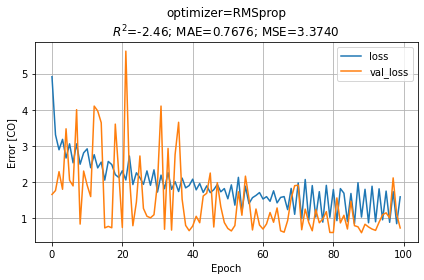

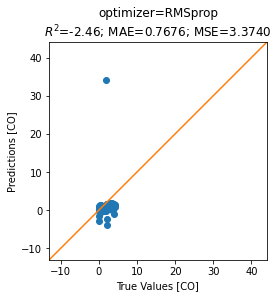

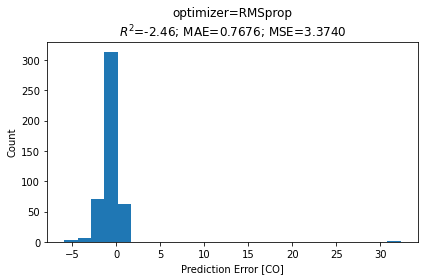

best mae...


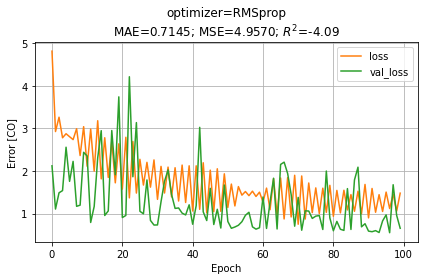

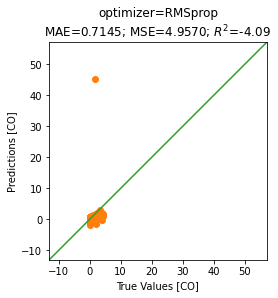

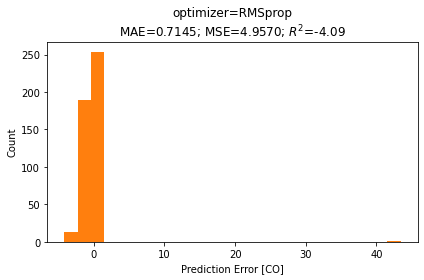

best mse...


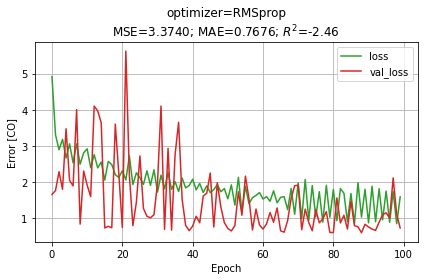

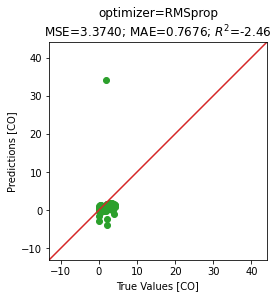

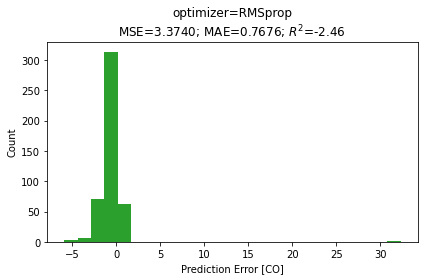


-CO===============================================================
CO done.
simulate... o:Adam | l:mae | m:mse | e:100...
CO busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


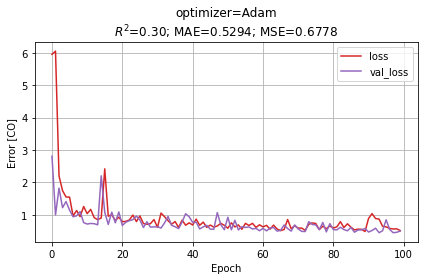

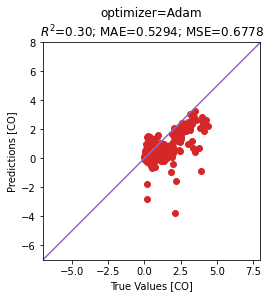

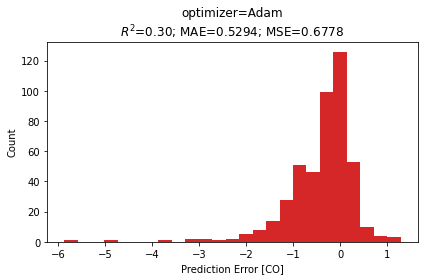

best mae...


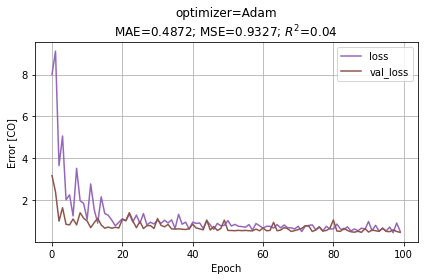

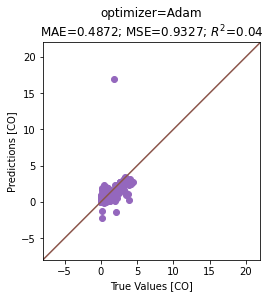

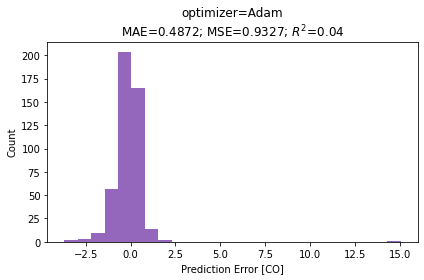

best mse...


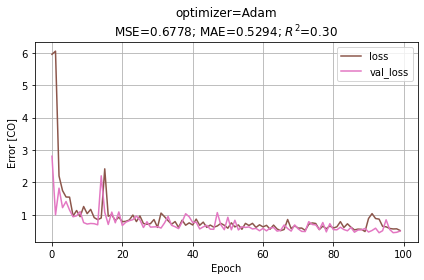

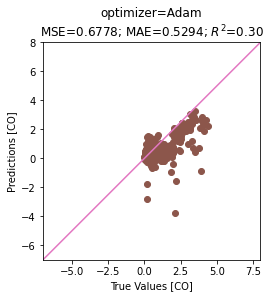

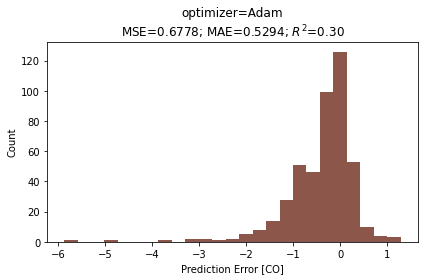


-CO===============================================================
CO done.
+CO2===============================================================
simulate... o:RMSprop | l:mae | m:mse | e:100...
CO2 busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


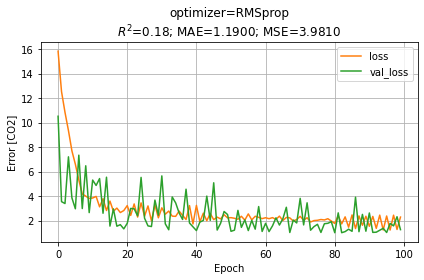

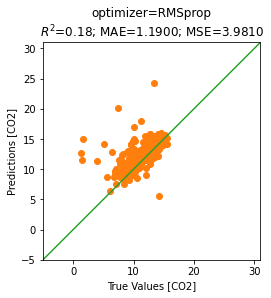

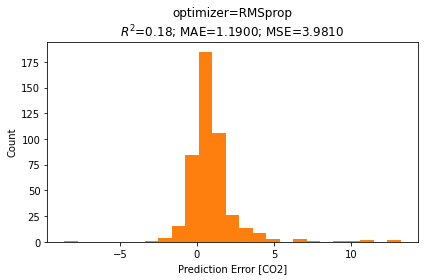

best mae...


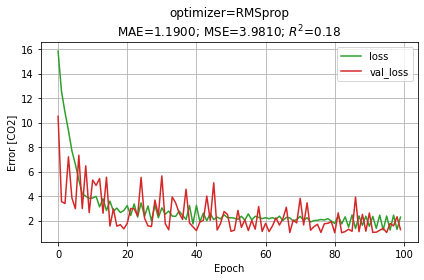

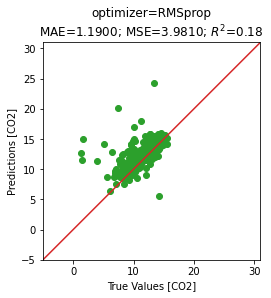

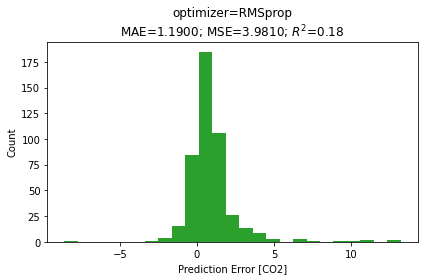

best mse...


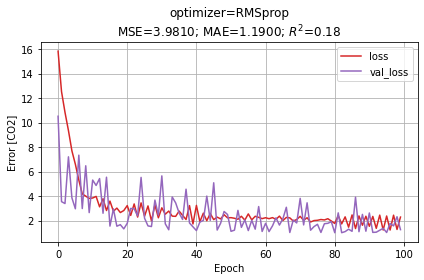

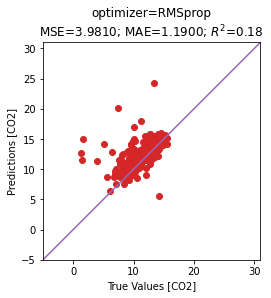

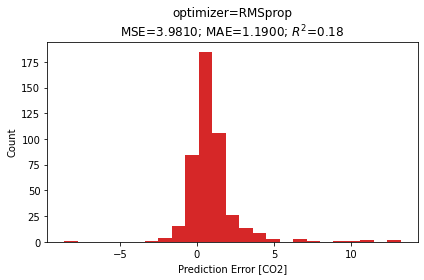


-CO2===============================================================
CO2 done.
simulate... o:Adam | l:mae | m:mse | e:100...
CO2 busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


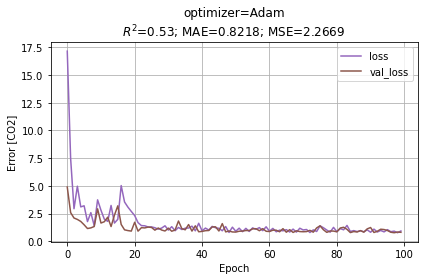

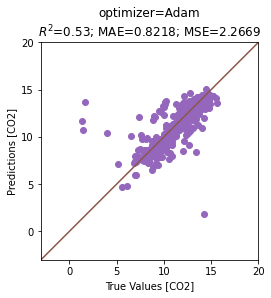

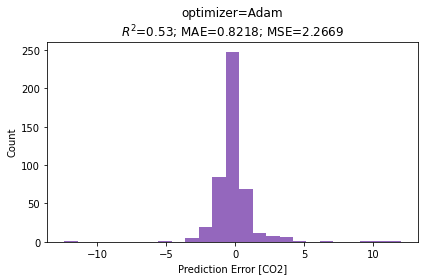

best mae...


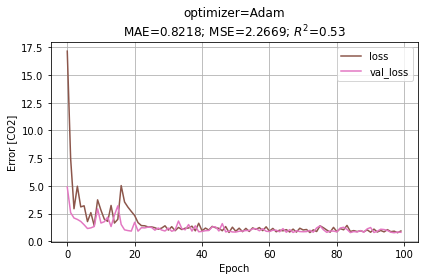

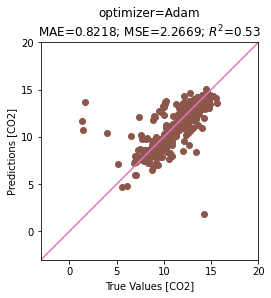

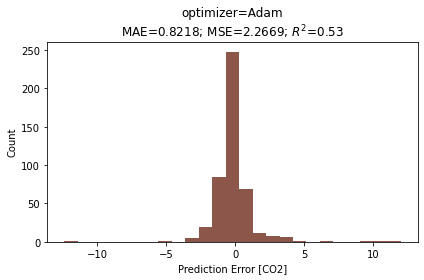

best mse...


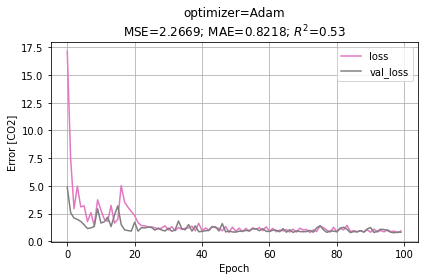

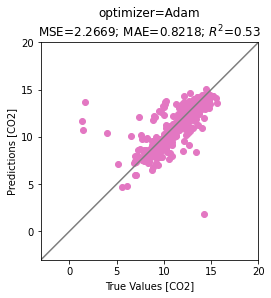

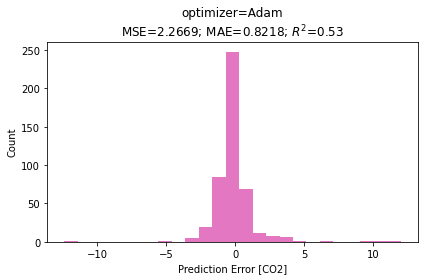


-CO2===============================================================
CO2 done.
+O2===============================================================
simulate... o:RMSprop | l:mae | m:mse | e:100...
O2 busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


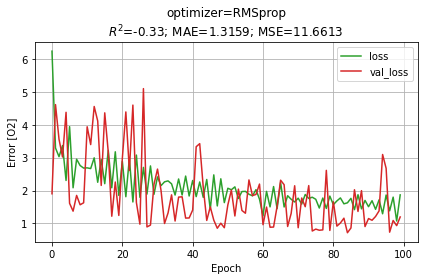

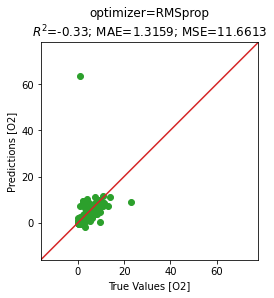

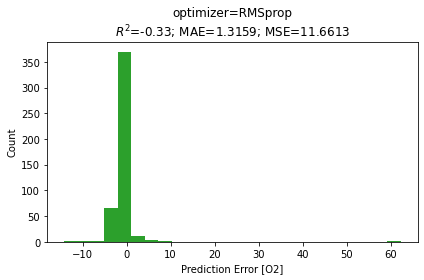

best mae...


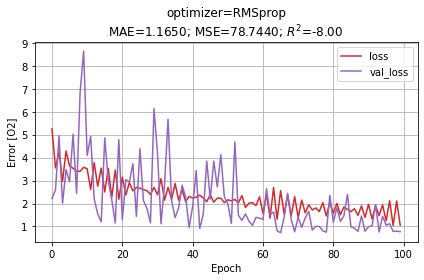

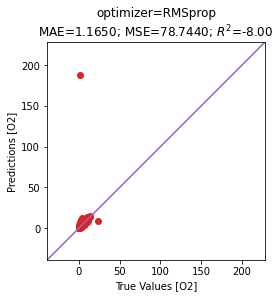

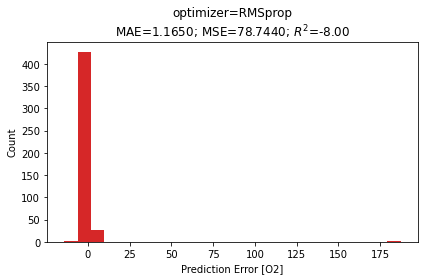

best mse...


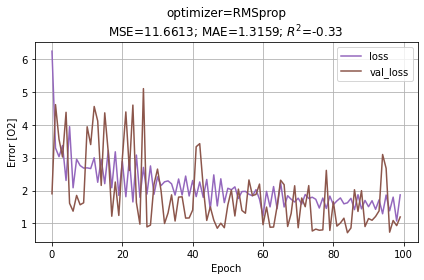

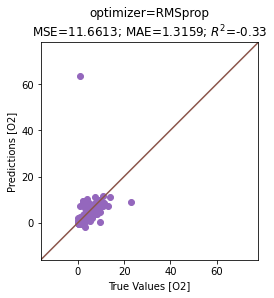

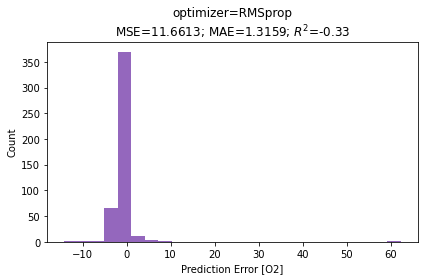


-O2===============================================================
O2 done.
simulate... o:Adam | l:mae | m:mse | e:100...
O2 busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


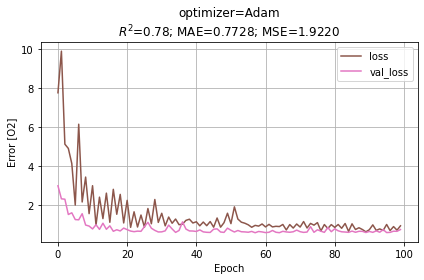

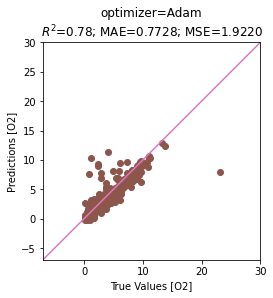

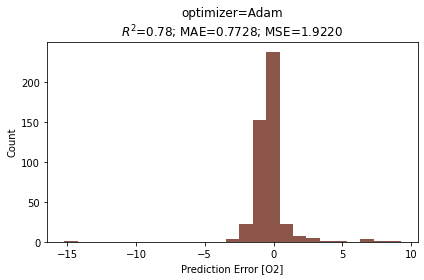

best mae...


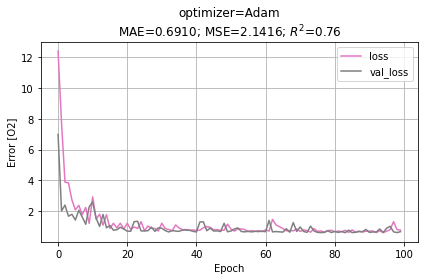

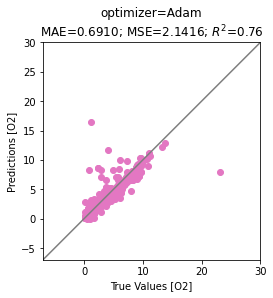

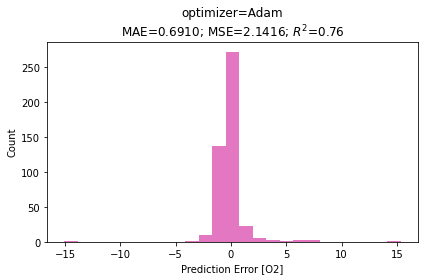

best mse...


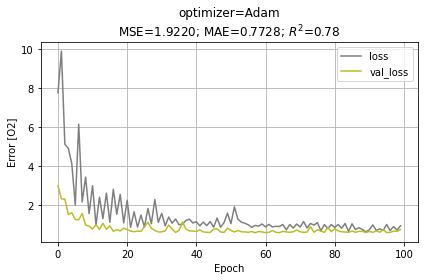

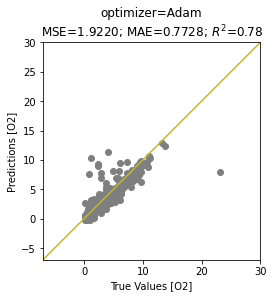

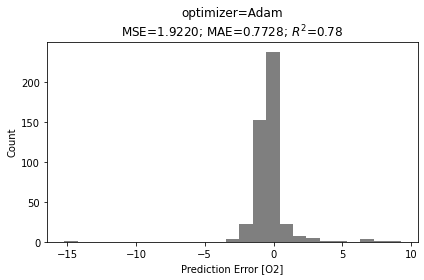


-O2===============================================================
O2 done.
+HC===============================================================
simulate... o:RMSprop | l:mae | m:mse | e:100...
HC busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


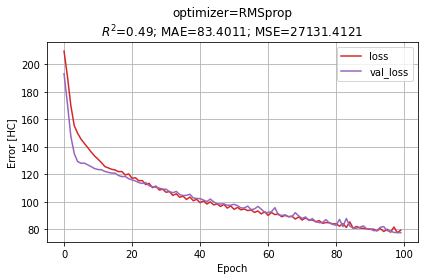

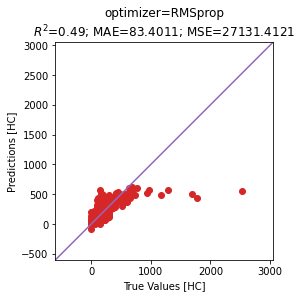

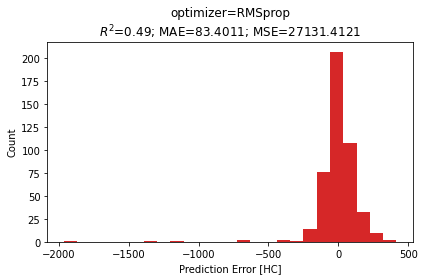

best mae...


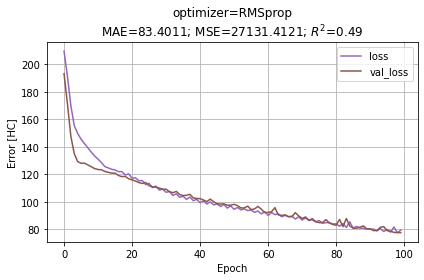

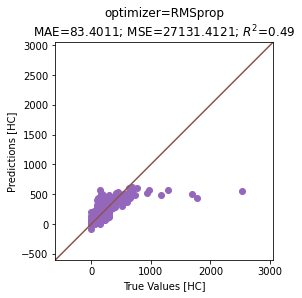

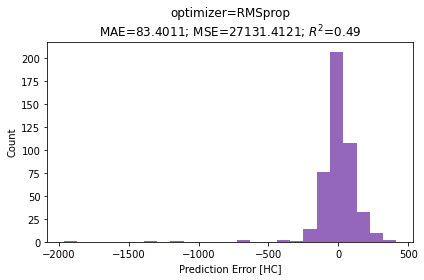

best mse...


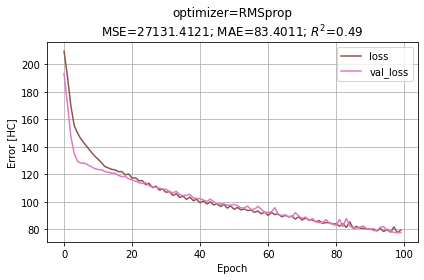

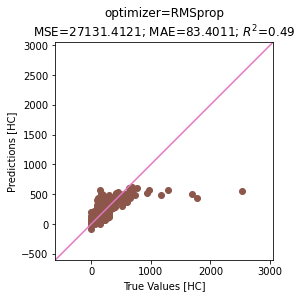

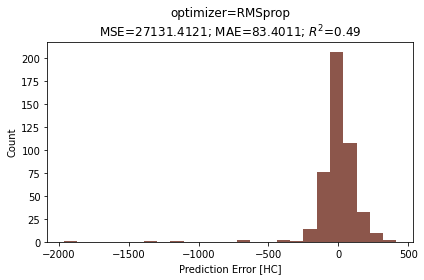


-HC===============================================================
HC done.
simulate... o:Adam | l:mae | m:mse | e:100...
HC busy.. . 1/5 . 2/5 . 3/5 . 4/5 . 5/5
best r2...


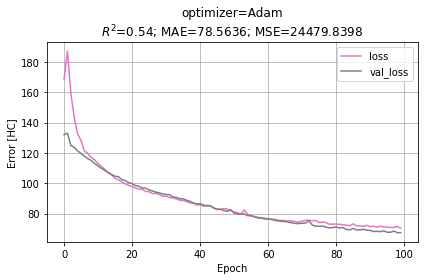

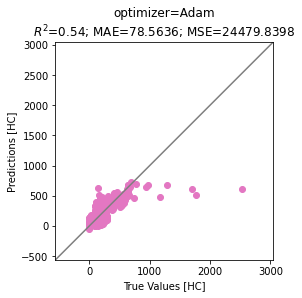

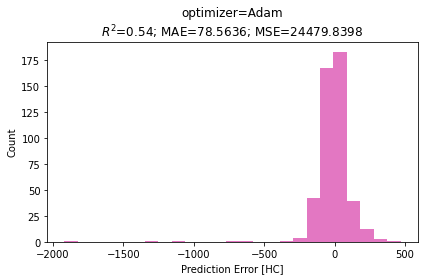

best mae...


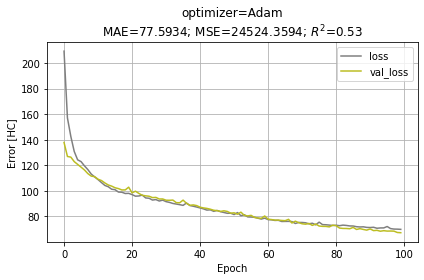

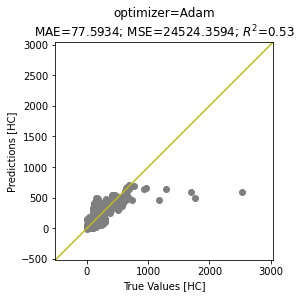

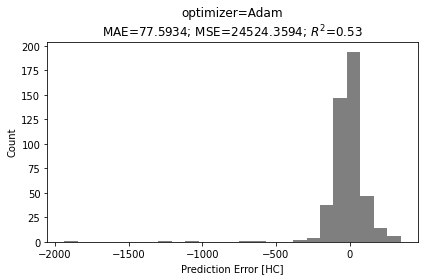

best mse...


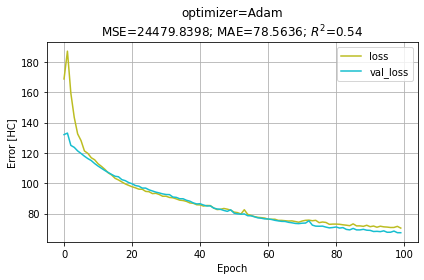

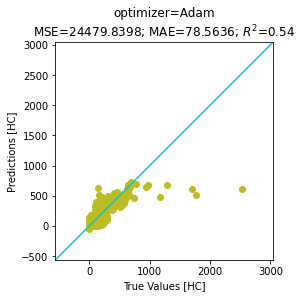

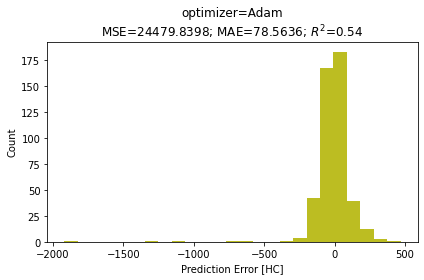


-HC===============================================================
HC done.


In [45]:
# 
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score

import datetime

dt = datetime.datetime.now()

uniqueId = dt.strftime("%Y%m%d%H%M%S")

h = 2

filePrefix = filePath + '_' + uniqueId

test_results_all = {}
testData = {}


targetCols = ['CO', 'CO2', 'O2', 'HC'
                # , 'lamda', 'AFR'
                # , 'Study'
                ]
for t,tgt in enumerate(targetCols):
    colorNo = t

    print(f'+{tgt}===============================================================')

    X = dataX.copy()
    X = X.loc[::h]

    #  Isolate target tgts
    y = X[tgt]

    # Isolate data
    X = X.drop(tgt, axis=1) 

    # Split the data up in train and test sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

    # 
    testData[tgt] = (X_test, y_test)


    # train
    M,N = X_train.shape

    # model
    normalizer = preprocessing.Normalization(input_dim=N)
    # normalizer.adapt(np.array(X_train))

    # optimizers
    learning_rate = 0.001

    dictOpt ={}
    dictOpt['RMSprop'] = keras.optimizers.RMSprop(lr=learning_rate)
    dictOpt['Adam'] =  tf.optimizers.Adam(learning_rate=learning_rate)

    optKey = 'Adam'
    optimizer = dictOpt[optKey]


    for optKey, optimizer in dictOpt.items():
        test_results = {}

        # loss
        loss='mae'

        # metrics
        metrics=['mse']

        # epochs
        epochs=100

        print(f'simulate... o:{optKey} | l:{loss} | m:{metrics[0]} | e:{epochs}...') 

        print(f'{tgt} busy..', end = "")  

        r2Limit = 1
        maxIteration = 5

        for i in range(maxIteration):
            model = build_and_compile_model(normalizer, optimizer, loss, N, metrics)
            # print(model.summary())

            print(f' . {i+1}/{maxIteration}', end = "")  
            history, loss_value, metrics_value, r2 = fit_evaluate(X_train, y_train, X_test, y_test, epochs )    

            simKey = f'{tgt}_{optKey}_{loss}_{epochs}_{i+1}'
            test_results[simKey] = model, history, loss_value, metrics_value, r2

        # best r2
        print('\nbest r2...')  
        # get best r2
        key = getBestR2(test_results)
        colorNo += 1
        simulateR2(test_results, key, tgt, X_test, y_test, colorNo, filePrefix)
        
        # best mae
        print('best mae...')  
        # get best mae
        key1 = getBestMAE(test_results)
        colorNo += 1
        simulateMAE(test_results, key1, tgt, X_test, y_test, colorNo, filePrefix)

        # best mse
        print('best mse...')  
        # get best mse
        key2 = getBestMSE(test_results)
        colorNo += 1
        simulateMSE(test_results, key2, tgt, X_test, y_test, colorNo, filePrefix)


        # save
        simKey = key + '_r2'
        test_results[simKey] = test_results[key]
        simKey = key1 + '_mae'
        test_results[simKey] = test_results[key1]
        simKey = key2 + '_mse'
        test_results[simKey] = test_results[key2]


        for k,v in test_results.items():
            test_results_all[k] = v
        
        print()
        print(f'-{tgt}===============================================================')
        print(f'{tgt} done.')  

In [46]:
d = [{'Model':k, 'Component':k.split('_')[0], 'Optimizer':k.split('_')[1],'Metric': k.split('_')[-1], 'MAE':v[-3],'MSE':v[-2],'R2':v[-1] } for k,v in test_results_all.items() ]
dfTestResults = pd.DataFrame(d)
dfTestResults


,Model,Component,Optimizer,Metric,MAE,MSE,R2
0,CO_RMSprop_mae_100_1,CO,RMSprop,1,0.714486,4.957026,-4.088464
1,CO_RMSprop_mae_100_2,CO,RMSprop,2,0.742038,14.555542,-13.941501
2,CO_RMSprop_mae_100_3,CO,RMSprop,3,0.760725,10.648502,-9.930855
3,CO_RMSprop_mae_100_4,CO,RMSprop,4,0.767643,3.373981,-2.463451
4,CO_RMSprop_mae_100_5,CO,RMSprop,5,1.960406,13.394946,-12.750132
...,...,...,...,...,...,...,...
59,HC_Adam_mae_100_4,HC,Adam,4,77.593414,24524.359375,0.534498
60,HC_Adam_mae_100_5,HC,Adam,5,78.563644,24479.839844,0.535343
61,HC_Adam_mae_100_5_r2,HC,Adam,r2,78.563644,24479.839844,0.535343
62,HC_Adam_mae_100_4_mae,HC,Adam,mae,77.593414,24524.359375,0.534498


In [47]:
fname = filePrefix + '__out.xlsx'

with pd.ExcelWriter(fname, engine='openpyxl') as writer:
    sheet = 'result'
    dfTestResults.to_excel(writer, sheet_name=sheet)

    tgt = ''
    for k,v in test_results_all.items():    
        dfH = pd.DataFrame(v[1].history)
        sheet = 'H_' + k
        dfH.to_excel(writer, sheet_name=sheet)

        # 
        tgt0 = k.split('_')[0]

        if tgt0 != tgt:
            tgt = tgt0
            (X_test, y_test) = testData[tgt]

            dfH = pd.DataFrame(X_test)
            sheet = 'X_' + k
            dfH.to_excel(writer, sheet_name=sheet)

        # 
        model = v[0]
        test_predictions = model.predict(X_test).flatten()
        dfH = pd.DataFrame({'YTest':y_test, 'YPred':test_predictions})
        sheet = 'P_' + k
        dfH.to_excel(writer, sheet_name=sheet)




In [48]:
1%2

1

In [49]:
dfTestResults

,Model,Component,Optimizer,Metric,MAE,MSE,R2
0,CO_RMSprop_mae_100_1,CO,RMSprop,1,0.714486,4.957026,-4.088464
1,CO_RMSprop_mae_100_2,CO,RMSprop,2,0.742038,14.555542,-13.941501
2,CO_RMSprop_mae_100_3,CO,RMSprop,3,0.760725,10.648502,-9.930855
3,CO_RMSprop_mae_100_4,CO,RMSprop,4,0.767643,3.373981,-2.463451
4,CO_RMSprop_mae_100_5,CO,RMSprop,5,1.960406,13.394946,-12.750132
...,...,...,...,...,...,...,...
59,HC_Adam_mae_100_4,HC,Adam,4,77.593414,24524.359375,0.534498
60,HC_Adam_mae_100_5,HC,Adam,5,78.563644,24479.839844,0.535343
61,HC_Adam_mae_100_5_r2,HC,Adam,r2,78.563644,24479.839844,0.535343
62,HC_Adam_mae_100_4_mae,HC,Adam,mae,77.593414,24524.359375,0.534498


In [50]:
(0+1)%2 == 1

True

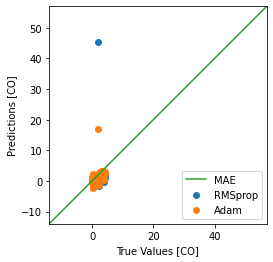

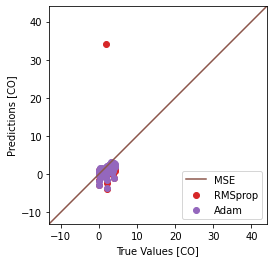

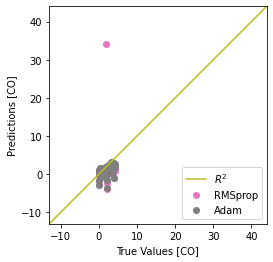

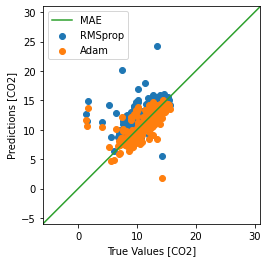

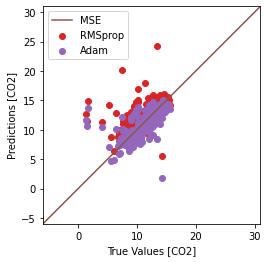

...

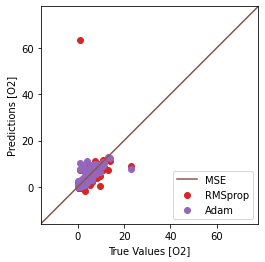

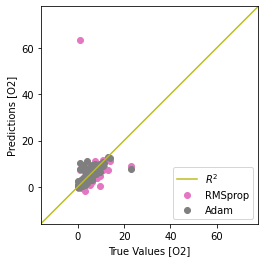

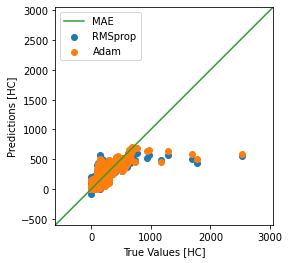

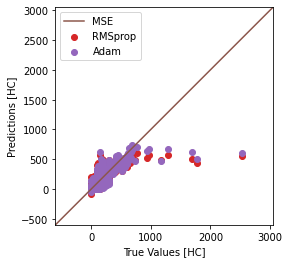

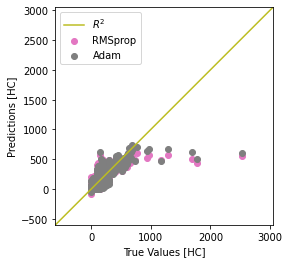

In [51]:
colorNo = 0

for tgt in targetCols:

    colorNo += 1
    for j,mtc in enumerate(['mae', 'mse', 
                 'r2'
                #  , 'mse'
                ]):
        
        # print(a,b)

        fname = filePrefix + '_' + tgt + '_' + mtc

        df = dfTestResults
        dfw = df[(df['Component'] == tgt) & (df['Metric'] == mtc)]

        (X_test, y_test) = testData[tgt]

        M,N = dfw.shape

        fig, ax = plt.subplots(
            # tight_layout=True
            )
        ax.set_aspect('equal')        

        for i in range(colorNo):
            color = next(ax._get_lines.prop_cycler)['color']

        lims1 = (0,0)

        for i in range(M):
            k = dfw['Model'].iloc[i]
            label = dfw['Optimizer'].iloc[i]

            v = test_results_all[k]
            model = v[0]
            yPred = model.predict(X_test).flatten()
            
            colorNo += 1
            ax.scatter(y_test, yPred, label=label, color = color)
            color = next(ax._get_lines.prop_cycler)['color']

            (x1,x2),(y1,y2) = (min(y_test), max(y_test)), (min(yPred), max(yPred))
            # print((x1,x2),(y1,y2))

            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2

            lims0 = (x1, x2)

            # print(lims0)
            (x1,x2),(y1,y2) = lims1, lims0
            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2
            lims1 = (x1, x2)
            # print(lims1)

        lims = get_lim([0,0], lims1)
        # print(lims)
        
        if mtc =='r2':
            label = '$R^2$'
        else:
            label = mtc.upper()
        colorNo += 1
        _ = ax.plot(lims, lims, color = color, label=label)

        ax.set_xlim(lims)
        ax.set_ylim(lims)

        xlabel=f'True Values [{tgt}]'
        ylabel=f'Predictions [{tgt}]'

        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)

        # # Shrink current axis by 20%
        # box = ax.get_position()
        # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

        # Put a legend to the right of the current axis
        ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

        plt.savefig(fname + '.svg')
        plt.savefig(fname + '.png')
        
        plt.show()


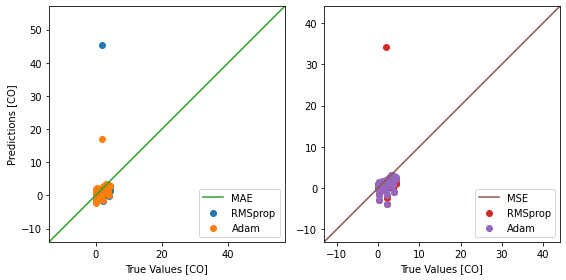

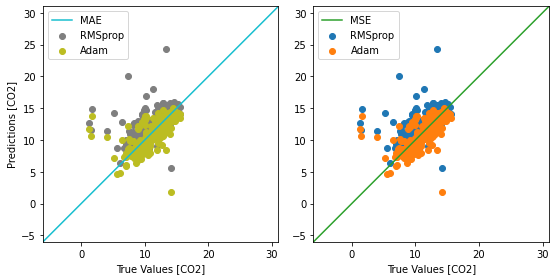

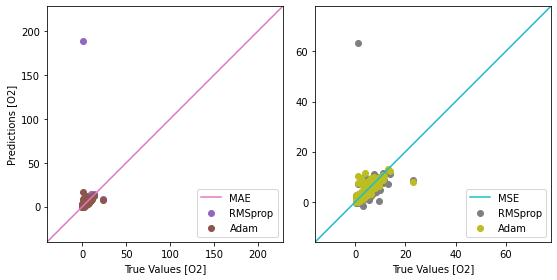

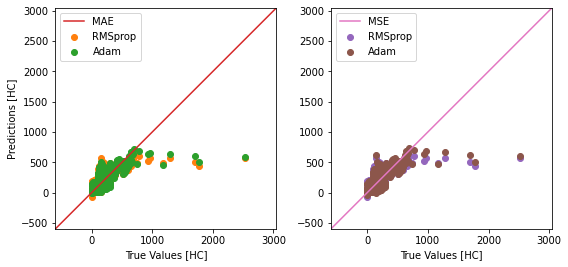

In [52]:
colorNo = 0
prows, pcols = 1,2

for tgt in targetCols:
    fig, axx = plt.subplots(prows, pcols, figsize=(8,4), 
            tight_layout=True
            )

    fname = f'{filePrefix}_{tgt}_{prows}{pcols}'

    colorNo += 1
    for j,mtc in enumerate(['mae', 'mse', 
                #  'r2'
                #  , 'mse'
                ]):
        
        a = j//2
        b = j%2

        # print(a,b)

        df = dfTestResults
        dfw = df[(df['Component'] == tgt) & (df['Metric'] == mtc)]

        (X_test, y_test) = testData[tgt]

        M,N = dfw.shape

        # ax = axx[a,b]
        ax = axx[j]
        ax.set_aspect('equal')        

        for i in range(colorNo):
            color = next(ax._get_lines.prop_cycler)['color']

        lims1 = (0,0)

        for i in range(M):
            k = dfw['Model'].iloc[i]
            label = dfw['Optimizer'].iloc[i]

            v = test_results_all[k]
            model = v[0]
            yPred = model.predict(X_test).flatten()
            
            colorNo += 1
            ax.scatter(y_test, yPred, label=label, color = color)
            color = next(ax._get_lines.prop_cycler)['color']

            (x1,x2),(y1,y2) = (min(y_test), max(y_test)), (min(yPred), max(yPred))
            # print((x1,x2),(y1,y2))

            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2

            lims0 = (x1, x2)

            # print(lims0)
            (x1,x2),(y1,y2) = lims1, lims0
            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2
            lims1 = (x1, x2)
            # print(lims1)

        lims = get_lim([0,0], lims1)
        # print(lims)
        
        if mtc =='r2':
            label = '$R^2$'
        else:
            label = mtc.upper()
        colorNo += 1
        _ = ax.plot(lims, lims, color = color, label=label)

        ax.set_xlim(lims)
        ax.set_ylim(lims)

        xlabel=f'True Values [{tgt}]'
        ylabel=f'Predictions [{tgt}]'

        if j >= ((prows*pcols)-pcols):
            ax.set_xlabel(xlabel)

        if (j+1)%2 == 1:
            ax.set_ylabel(ylabel)

        # # Shrink current axis by 20%
        # box = ax.get_position()
        # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

        # Put a legend to the right of the current axis
        ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

        # plt.savefig(fname + '.svg')
        # plt.savefig(fname + '.png')

    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')
    plt.show()


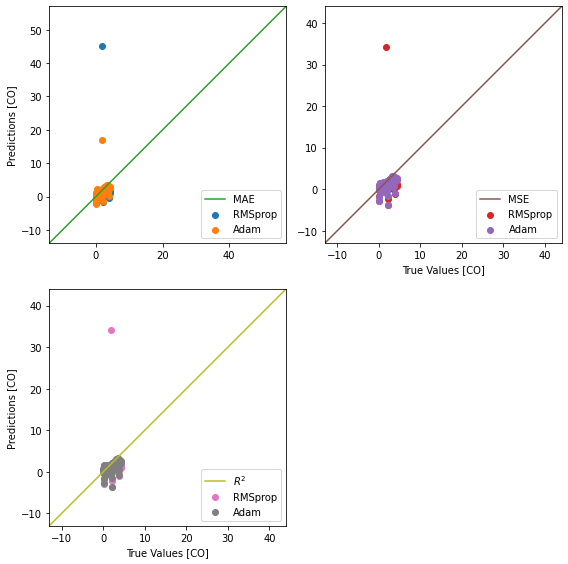

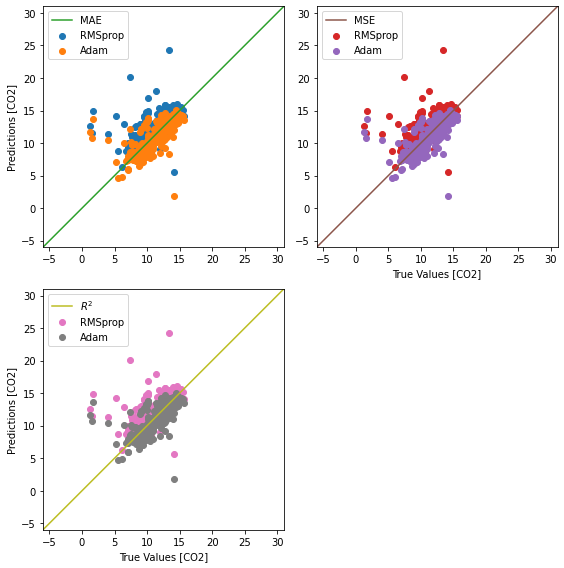

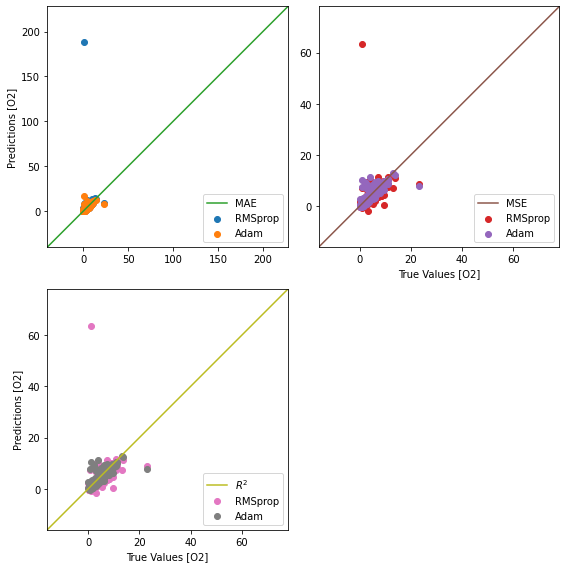

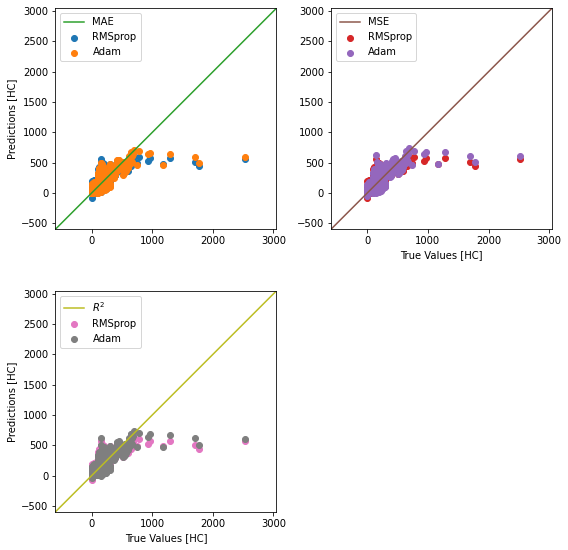

In [53]:
colorNo = 0
prows, pcols = 2,2

for tgt in targetCols:
    fig, axx = plt.subplots(prows, pcols, figsize=(8,8), 
            tight_layout=True
            )
    fig.delaxes(axx[1,1])

    fname = f'{filePrefix}_{tgt}_{prows}{pcols}'

    metricCols = ['mae', 'mse', 
                 'r2'
                #  , 'mse'
                ]
    metricsNo = len(metricCols)

    colorNo += 1
    for j,mtc in enumerate(metricCols):
        
        a = j//2
        b = j%2

        # print(a,b)

        df = dfTestResults
        dfw = df[(df['Component'] == tgt) & (df['Metric'] == mtc)]

        (X_test, y_test) = testData[tgt]

        M,N = dfw.shape

        ax = axx[a,b]
        ax.set_aspect('equal')        

        for i in range(colorNo):
            color = next(ax._get_lines.prop_cycler)['color']

        lims1 = (0,0)

        for i in range(M):
            k = dfw['Model'].iloc[i]
            label = dfw['Optimizer'].iloc[i]

            v = test_results_all[k]
            model = v[0]
            yPred = model.predict(X_test).flatten()
            
            colorNo += 1
            ax.scatter(y_test, yPred, label=label, color = color)
            color = next(ax._get_lines.prop_cycler)['color']

            (x1,x2),(y1,y2) = (min(y_test), max(y_test)), (min(yPred), max(yPred))
            # print((x1,x2),(y1,y2))

            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2

            lims0 = (x1, x2)

            # print(lims0)
            (x1,x2),(y1,y2) = lims1, lims0
            if x1 > y1:
                x1 = y1
            if x2 < y2:
                x2 = y2
            lims1 = (x1, x2)
            # print(lims1)

        lims = get_lim([0,0], lims1)
        # print(lims)
        
        if mtc =='r2':
            label = '$R^2$'
        else:
            label = mtc.upper()
        colorNo += 1
        _ = ax.plot(lims, lims, color = color, label=label)

        ax.set_xlim(lims)
        ax.set_ylim(lims)

        xlabel=f'True Values [{tgt}]'
        ylabel=f'Predictions [{tgt}]'

        if j >= ((prows*pcols)-pcols):
            ax.set_xlabel(xlabel)

        if (j+1)%2 == 1:
            ax.set_ylabel(ylabel)
        else:
            if ((j+1) +2) > metricsNo:
                ax.set_xlabel(xlabel)




        # # Shrink current axis by 20%
        # box = ax.get_position()
        # ax.set_position([box.x0, box.y0, box.width * 0.8, box.height])

        # Put a legend to the right of the current axis
        ax.legend(loc='best') #, bbox_to_anchor=(1, 0.5))

        # plt.savefig(fname + '.svg')
        # plt.savefig(fname + '.png')

    plt.savefig(fname + '.svg')
    plt.savefig(fname + '.png')
    plt.show()
